# Import libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

import os
import warnings

from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.cluster import KMeans

from statsmodels.tsa.holtwinters import ExponentialSmoothing

warnings.filterwarnings("ignore")
pd.set_option('display.float_format', '{:.2f}'.format)

# Download file

In [2]:
file_id = "1atOZX3YXmxx-_QebbTfndeC6U_DPTL2e" # ID of the file on Google Drive
file_name = 'Updated_data_2021&2022.csv'

# Run the download.ipynb file
%run download.ipynb

# Import Data

In [3]:
# File path
current_dir = os.getcwd()
parent_dir = os.path.dirname(current_dir)
file_path = os.path.join(parent_dir, 'Data',file_name)

# Import csv file and preview
df = pd.read_csv(file_path)
df.head()

,DATE_DIM,DAY_OF_WEEK,BET_ACCOUNT_NUM_HASH,AGE,AGE_BAND,GENDER,TENURE_IN_DAYS,RESIDENTIAL_STATE,FOB_RACING_TURNOVER,FOB_SPORT_TURNOVER,PARI_RACING_TURNOVER,PARI_SPORT_TURNOVER,TOTAL_TURNOVER,DIVIDENDS_PAID,GROSS_MARGIN,TICKETS
0,2021-01-01,Fri,13154,67.00,65+,M,11846,WA,37.00,NaN,1081.00,NaN,1118.00,443.55,271.25,288
1,2021-01-01,Fri,18379,54.00,45-54,M,1884,WA,40.00,NaN,NaN,NaN,40.00,0.00,40.00,1
2,2021-01-01,Fri,559232,63.00,55-64,M,2866,WA,NaN,NaN,12.00,NaN,12.00,9.50,2.04,5
3,2021-01-01,Fri,698904,69.00,65+,M,2100,WA,NaN,NaN,1223.50,NaN,1223.50,267.91,245.12,40
4,2021-01-01,Fri,762921,67.00,65+,M,4766,WA,NaN,NaN,17.50,NaN,17.50,0.00,3.50,5


# Aggregate

In [4]:
# Create columns
df['FOB_TURNOVER'] = df[['FOB_RACING_TURNOVER','FOB_SPORT_TURNOVER']].sum(axis=1)
df['PARI_TURNOVER'] = df[['PARI_RACING_TURNOVER','PARI_SPORT_TURNOVER']].sum(axis=1)
df['RACING_TURNOVER'] = df[['FOB_RACING_TURNOVER','PARI_RACING_TURNOVER']].sum(axis=1)
df['SPORT_TURNOVER'] = df[['FOB_SPORT_TURNOVER','PARI_SPORT_TURNOVER']].sum(axis=1)

# Aggregate
cus_df = df.groupby('BET_ACCOUNT_NUM_HASH', as_index=False) \
            .agg({'AGE': 'max', 
                  'DATE_DIM': 'count',
                  'RACING_TURNOVER' : 'sum', 
                  'FOB_TURNOVER' : 'sum', 
                  'TOTAL_TURNOVER' : 'sum', 
                  'DIVIDENDS_PAID' : 'sum',
                  'GROSS_MARGIN' : 'sum', 
                  'TICKETS' : 'sum'})

# Create ratio columns
cus_df['RACING_TURNOVER_PER'] = cus_df['RACING_TURNOVER'] / cus_df['TOTAL_TURNOVER'] * 100
cus_df['FOB_TURNOVER_PER'] = cus_df['FOB_TURNOVER'] / cus_df['TOTAL_TURNOVER'] * 100
cus_df['DIVIDENDS_PAID_PER'] = cus_df['DIVIDENDS_PAID'] / cus_df['TOTAL_TURNOVER'] * 100
cus_df['GROSS_MARGIN_PER'] = cus_df['GROSS_MARGIN'] / cus_df['TOTAL_TURNOVER'] * 100

# Drop columns
cus_df.drop(['RACING_TURNOVER', 'FOB_TURNOVER', 'DIVIDENDS_PAID', 'GROSS_MARGIN' ], axis=1, inplace=True)

# Impute age
cus_df.fillna(44, inplace=True)

# Define X
X = cus_df.iloc[:, 1:]

# Preview
cus_df.head()

,BET_ACCOUNT_NUM_HASH,AGE,DATE_DIM,TOTAL_TURNOVER,TICKETS,RACING_TURNOVER_PER,FOB_TURNOVER_PER,DIVIDENDS_PAID_PER,GROSS_MARGIN_PER
0,13154,67.00,463,366186.08,113627,100.00,8.50,73.96,22.37
1,18379,54.00,199,32033.00,841,99.69,87.48,73.86,20.75
2,37251,22.00,1,100.00,7,100.00,65.00,760.00,-689.65
3,129273,22.00,16,155.00,37,40.00,100.00,96.42,3.58
4,348318,29.00,4,30.00,17,83.33,90.00,0.00,91.94


# Clustering without scaling

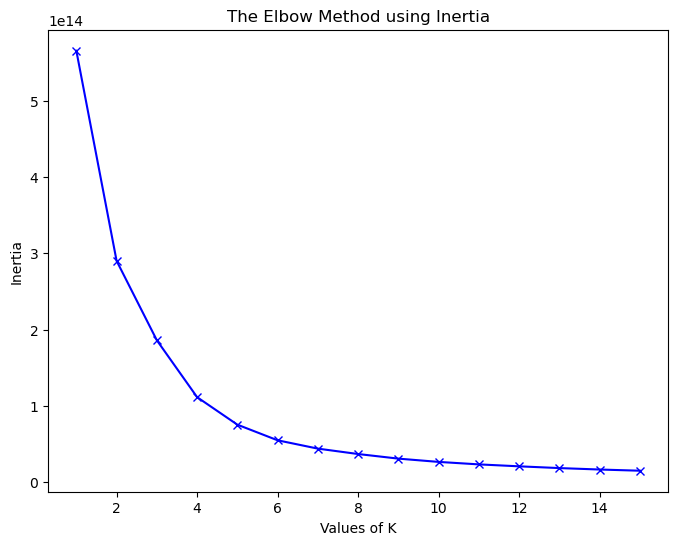

In [5]:
X = cus_df.iloc[:, 1:]
inertias = []
K = range(1, 16)

for k in K:
    kmeans_model = KMeans(n_clusters=k)
    kmeans_model.fit(X)
    inertias.append(kmeans_model.inertia_)

plt.figure(figsize=(8,6))

plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

# Clustering wtih scaling

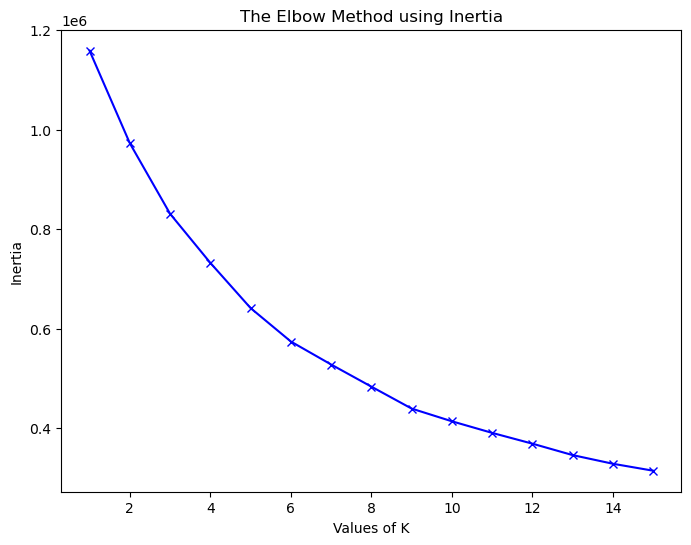

In [6]:
X = cus_df.iloc[:, 1:]
inertias = []
silhouettes = []
K = range(1, 16)

for k in K:
    pipeline = Pipeline([
    ("std_scaler", StandardScaler()) ,
    ("kmeans", KMeans(n_clusters=k)),
    ])
    
    pipeline.fit(X)
    inertias.append(pipeline.named_steps["kmeans"].inertia_)

plt.figure(figsize=(8,6))

plt.plot(K, inertias, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Inertia')
plt.title('The Elbow Method using Inertia')
plt.show()

Choose n_cluster = 7

# PCA to visualize clusters

In [7]:
kmeans_pipeline = Pipeline([
    ("std_scaler", StandardScaler()) ,
    ("kmeans", KMeans(n_clusters=7, random_state=42)),
])

kmeans_pipeline.fit(X)
inertias.append(kmeans_pipeline.named_steps["kmeans"].inertia_)

labels = kmeans_pipeline.predict(X)
labels

array([5, 2, 4, ..., 6, 1, 3])

### 2D

In [8]:
pca_pipeline = Pipeline([
    ("std_scaler", StandardScaler()) ,
    ("PCA", PCA(n_components=2, random_state=42)),
]) 

pca_pipeline.fit(X)
X_PCA = pca_pipeline.transform(X)

explained_variance_ratio = pca_pipeline.named_steps['PCA'].explained_variance_ratio_
explained_variance_ratio

array([0.27118319, 0.21987643])

(-3.0, 20.0)

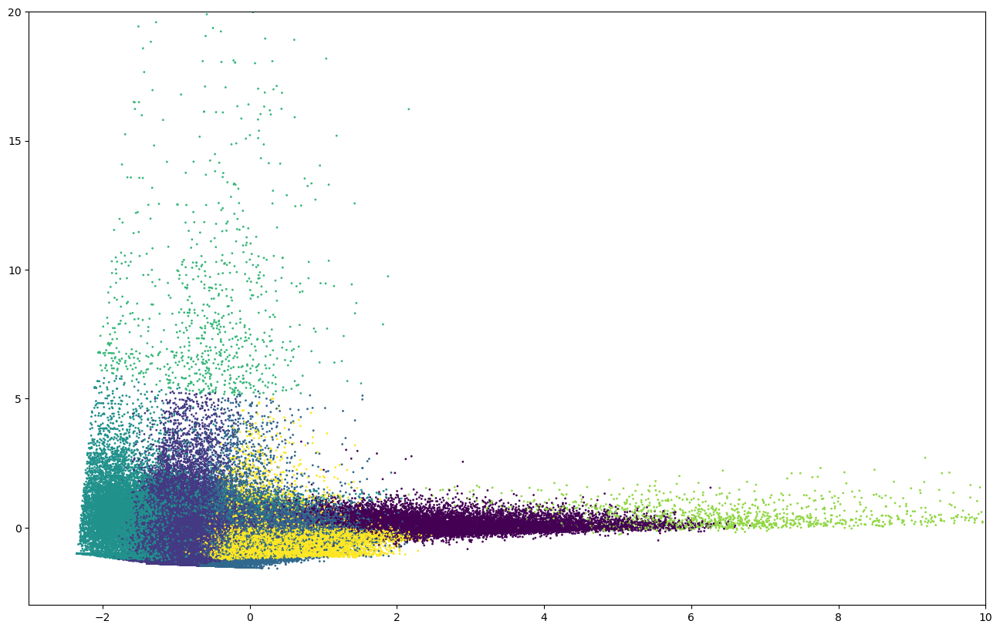

In [9]:
plt.figure(figsize=(16,10))
plt.scatter(X_PCA[:,0], X_PCA[:,1], c= labels, s=1)
plt.xlim(-3,10)
plt.ylim(-3,20)

In [10]:
pca_pipeline = Pipeline([
    ("std_scaler", StandardScaler()) ,
    ("PCA", PCA(n_components=3, random_state=42)),
]) 

pca_pipeline.fit(X)
X_PCA = pca_pipeline.transform(X)

explained_variance_ratio = pca_pipeline.named_steps['PCA'].explained_variance_ratio_
explained_variance_ratio

array([0.27118319, 0.21987643, 0.16268059])

### 3D

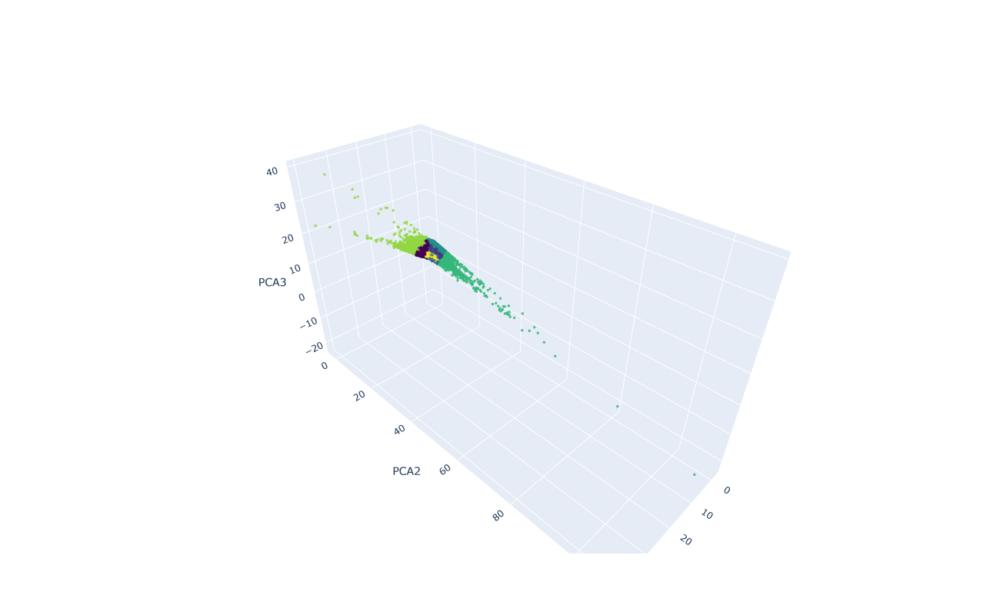

In [11]:
fig = go.Figure(data=go.Scatter3d(
    x=X_PCA[:, 0],
    y=X_PCA[:, 1],
    z=X_PCA[:, 2],
    mode='markers',
    marker=dict(
        size=2,
        color=labels,  # Assign color based on z-axis values
        colorscale='Viridis',  # Choose a color scale
        opacity=0.8
    )
))

# Set layout options
fig.update_layout(
    scene=dict(
        xaxis_title='PCA1',
        yaxis_title='PCA2',
        zaxis_title='PCA3'
    ),
    width=1000,
    height=800
)

# Display the plot
fig.show()